### <center><b>Leukemia Gene Data Analysis</b></center> 

In [68]:
import pandas as pd
import numpy as np
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder
import pandas_profiling as pp
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
df_base = pd.read_csv('data/Leukemia_GSE9476.csv')
df_base.head()

,samples,type,1007_s_at,1053_at,117_at,121_at,1255_g_at,1294_at,1316_at,1320_at,...,217003_s_at,217004_s_at,217005_at,217006_x_at,217007_s_at,217008_s_at,217009_at,217010_s_at,217011_at,217012_at
0,1,Bone_Marrow_CD34,7.745245,7.811210,6.477916,8.841506,4.546941,7.957714,5.344999,4.673364,...,5.231046,4.260848,5.217443,4.929020,6.782879,4.745993,4.760791,5.157177,6.761590,3.842140
1,12,Bone_Marrow_CD34,8.087252,7.240673,8.584648,8.983571,4.548934,8.011652,5.579647,4.828184,...,5.497441,4.324216,5.304464,5.129407,7.086331,4.730853,4.778076,4.973729,7.033600,4.021686
2,13,Bone_Marrow_CD34,7.792056,7.549368,11.053504,8.909703,4.549328,8.237099,5.406489,4.615572,...,5.393424,4.327717,5.367881,5.091252,6.362385,4.855343,4.713425,5.116340,6.877516,3.883643
3,14,Bone_Marrow_CD34,7.767265,7.094460,11.816433,8.994654,4.697018,8.283412,5.582195,4.903684,...,5.343483,4.462715,5.296296,4.918712,6.409645,4.768583,4.843132,5.392526,6.991575,3.961990
4,15,Bone_Marrow_CD34,8.010117,7.405281,6.656049,9.050682,4.514986,8.377046,5.493713,4.860754,...,5.586353,4.471274,5.461786,4.994652,6.384314,4.855328,4.611975,5.312051,6.817168,3.964178


In [3]:
df_base.shape

(64, 16384)

> Samples column is just the sample id so dropping it

In [4]:
df_base = df_base.drop(['samples'], axis=1)
df_base.head()

,type,1007_s_at,1053_at,117_at,121_at,1255_g_at,1294_at,1316_at,1320_at,1405_i_at,...,217003_s_at,217004_s_at,217005_at,217006_x_at,217007_s_at,217008_s_at,217009_at,217010_s_at,217011_at,217012_at
0,Bone_Marrow_CD34,7.745245,7.811210,6.477916,8.841506,4.546941,7.957714,5.344999,4.673364,4.664924,...,5.231046,4.260848,5.217443,4.929020,6.782879,4.745993,4.760791,5.157177,6.761590,3.842140
1,Bone_Marrow_CD34,8.087252,7.240673,8.584648,8.983571,4.548934,8.011652,5.579647,4.828184,5.171835,...,5.497441,4.324216,5.304464,5.129407,7.086331,4.730853,4.778076,4.973729,7.033600,4.021686
2,Bone_Marrow_CD34,7.792056,7.549368,11.053504,8.909703,4.549328,8.237099,5.406489,4.615572,4.775709,...,5.393424,4.327717,5.367881,5.091252,6.362385,4.855343,4.713425,5.116340,6.877516,3.883643
3,Bone_Marrow_CD34,7.767265,7.094460,11.816433,8.994654,4.697018,8.283412,5.582195,4.903684,4.829844,...,5.343483,4.462715,5.296296,4.918712,6.409645,4.768583,4.843132,5.392526,6.991575,3.961990
4,Bone_Marrow_CD34,8.010117,7.405281,6.656049,9.050682,4.514986,8.377046,5.493713,4.860754,5.245049,...,5.586353,4.471274,5.461786,4.994652,6.384314,4.855328,4.611975,5.312051,6.817168,3.964178


#### Out of the total columns 16382 are the float, 1 is int64 whereas 1 is obj

In [5]:
df_base.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64 entries, 0 to 63
Columns: 16383 entries, type to 217012_at
dtypes: float64(16382), object(1)
memory usage: 8.0+ MB


In [6]:
df_base.describe()

,1007_s_at,1053_at,117_at,121_at,1255_g_at,1294_at,1316_at,1320_at,1405_i_at,1431_at,...,217003_s_at,217004_s_at,217005_at,217006_x_at,217007_s_at,217008_s_at,217009_at,217010_s_at,217011_at,217012_at
count,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,...,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000
mean,7.819371,6.750455,7.475593,8.898925,4.513390,8.282604,5.544487,4.710160,6.679214,4.106471,...,5.433630,4.382162,5.417031,5.063095,6.708816,4.863381,4.737346,5.092285,6.860524,3.945886
std,0.169830,0.375415,1.308313,0.208462,0.096836,0.408621,0.140410,0.135293,1.583527,0.114457,...,0.180128,0.121229,0.171237,0.183949,0.319027,0.199684,0.112440,0.241523,0.140812,0.103307
min,7.278076,6.103252,6.296965,8.486306,4.351181,7.331400,5.295685,4.352735,4.543998,3.893359,...,5.134099,4.078628,5.124036,4.771870,6.114925,4.379414,4.469651,4.651732,6.578248,3.727452
25%,7.701161,6.503295,6.640182,8.765333,4.449243,8.015841,5.454499,4.623445,5.211335,4.033372,...,5.300623,4.297405,5.293899,4.951018,6.519220,4.729704,4.666559,4.933932,6.774544,3.876755
50%,7.814811,6.724425,6.794160,8.871007,4.509827,8.230027,5.547004,4.674101,6.532190,4.103116,...,5.417227,4.362941,5.392436,5.046101,6.659282,4.828583,4.722344,5.048063,6.855705,3.937151
75%,7.960393,6.929274,7.888134,9.023418,4.567569,8.515215,5.605790,4.789000,8.278395,4.145247,...,5.538447,4.473347,5.517985,5.165562,6.828575,4.987931,4.810460,5.261357,6.967133,4.023268
max,8.167701,7.962858,11.816433,9.458264,4.754915,9.595609,5.977147,5.193624,9.985429,4.583933,...,5.966019,4.674341,6.023924,5.924208,8.259095,5.511116,4.990461,5.950243,7.170366,4.245976


In [7]:
df_base.dtypes

type            object
1007_s_at      float64
1053_at        float64
117_at         float64
121_at         float64
                ...   
217008_s_at    float64
217009_at      float64
217010_s_at    float64
217011_at      float64
217012_at      float64
Length: 16383, dtype: object

In [8]:
df_base.columns[df_base.dtypes!='float64']

Index(['type'], dtype='object')

#### We dont have any categorical feature in the dataset, 'samples' column is of int type, whereas 'type' column is the output variable for us

In [9]:
y_act = df_base['type']
df_base[['type']].dtypes

type    object
dtype: object

#### There are no null values in all the column of the dataset

In [10]:
df_base.columns[df_base.isna().any()].to_list()

[]

In [11]:
## Label Encoding target variable

le = LabelEncoder()
le.fit(df_base['type'])
le_name_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
print(le_name_mapping)
df_base['type']= le.fit_transform(df_base['type'])

{'AML': 0, 'Bone_Marrow': 1, 'Bone_Marrow_CD34': 2, 'PB': 3, 'PBSC_CD34': 4}


In [12]:
df_base.head()

,type,1007_s_at,1053_at,117_at,121_at,1255_g_at,1294_at,1316_at,1320_at,1405_i_at,...,217003_s_at,217004_s_at,217005_at,217006_x_at,217007_s_at,217008_s_at,217009_at,217010_s_at,217011_at,217012_at
0,2,7.745245,7.811210,6.477916,8.841506,4.546941,7.957714,5.344999,4.673364,4.664924,...,5.231046,4.260848,5.217443,4.929020,6.782879,4.745993,4.760791,5.157177,6.761590,3.842140
1,2,8.087252,7.240673,8.584648,8.983571,4.548934,8.011652,5.579647,4.828184,5.171835,...,5.497441,4.324216,5.304464,5.129407,7.086331,4.730853,4.778076,4.973729,7.033600,4.021686
2,2,7.792056,7.549368,11.053504,8.909703,4.549328,8.237099,5.406489,4.615572,4.775709,...,5.393424,4.327717,5.367881,5.091252,6.362385,4.855343,4.713425,5.116340,6.877516,3.883643
3,2,7.767265,7.094460,11.816433,8.994654,4.697018,8.283412,5.582195,4.903684,4.829844,...,5.343483,4.462715,5.296296,4.918712,6.409645,4.768583,4.843132,5.392526,6.991575,3.961990
4,2,8.010117,7.405281,6.656049,9.050682,4.514986,8.377046,5.493713,4.860754,5.245049,...,5.586353,4.471274,5.461786,4.994652,6.384314,4.855328,4.611975,5.312051,6.817168,3.964178


### Different Classes Distribution in the Data

In [13]:
from sklearn.model_selection import train_test_split,KFold

In [14]:
train_df,test_df = train_test_split(df_base,test_size=0.2,random_state=11)
# print(train_df.head())
print(f"PORTION OF TYPE IN ORIGINAL DATA\n{df_base['type'].value_counts() / len(df_base)}\n\n" +
      f"PORTION OF TYPE IN TRAIN DATA\n{train_df['type'].value_counts() / len(train_df)}\n\n"+
      f"PORTION OF TYPE IN TEST DATA\n{test_df['type'].value_counts() / len(test_df)}\n\n")


PORTION OF TYPE IN ORIGINAL DATA
0    0.40625
1    0.15625
3    0.15625
4    0.15625
2    0.12500
Name: type, dtype: float64

PORTION OF TYPE IN TRAIN DATA
0    0.411765
1    0.176471
4    0.156863
3    0.137255
2    0.117647
Name: type, dtype: float64

PORTION OF TYPE IN TEST DATA
0    0.384615
3    0.230769
4    0.153846
2    0.153846
1    0.076923
Name: type, dtype: float64




* As we could see the data is not distributed equally among the different samples so we apply startified sampling in it.

In [15]:
train_df,test_df = train_test_split(df_base,test_size=0.2,stratify=df_base['type'] ,random_state=11)

print(f'PROPORTION OF TYPE IN THE ORIGINAL DATA\n{df_base["type"].value_counts() / len(df_base)}\n\n'+
      f'PROPORTION OF TYPE IN THE TRAINING SET\n{train_df["type"].value_counts() / len(train_df)}\n\n'+
      f'PROPORTION OF TYPE IN THE TEST SET\n{test_df["type"].value_counts() / len(test_df)}')

PROPORTION OF TYPE IN THE ORIGINAL DATA
0    0.40625
1    0.15625
3    0.15625
4    0.15625
2    0.12500
Name: type, dtype: float64

PROPORTION OF TYPE IN THE TRAINING SET
0    0.411765
1    0.156863
3    0.156863
4    0.156863
2    0.117647
Name: type, dtype: float64

PROPORTION OF TYPE IN THE TEST SET
0    0.384615
4    0.153846
3    0.153846
1    0.153846
2    0.153846
Name: type, dtype: float64


* Even after startified we could see the AML type lukemia has higher training data than all other ['Bone_Marrow_CD34', 'Bone_Marrow', 'PB', 'PBSC_CD34']
* We need to perform the upsampling of the data 

### Correlation

In [16]:
df_base.shape

(64, 16383)

In [17]:
corr = df_base.corr()
corr.head()

,type,1007_s_at,1053_at,117_at,121_at,1255_g_at,1294_at,1316_at,1320_at,1405_i_at,...,217003_s_at,217004_s_at,217005_at,217006_x_at,217007_s_at,217008_s_at,217009_at,217010_s_at,217011_at,217012_at
type,1.000000,0.084142,0.109590,0.237667,-0.300848,-0.279864,0.217180,-0.150859,-0.133693,-0.164291,...,-0.247542,-0.155515,0.044203,-0.020910,-0.227582,-0.206818,-0.160545,-0.046787,-0.006723,-0.175103
1007_s_at,0.084142,1.000000,-0.211397,0.048428,0.550651,0.532581,-0.187816,0.605351,0.341193,-0.252403,...,0.639063,0.456670,0.444411,-0.019020,-0.050761,0.346452,0.317014,0.463506,0.494009,0.242674
1053_at,0.109590,-0.211397,1.000000,0.052046,-0.019107,-0.092464,0.004193,-0.211481,0.091480,-0.458993,...,-0.318155,-0.266137,-0.428232,-0.218048,0.169043,-0.185715,-0.114602,0.079369,-0.152079,-0.547508
117_at,0.237667,0.048428,0.052046,1.000000,-0.087912,0.139514,-0.156873,0.129338,0.022923,0.130044,...,0.084468,0.305893,0.218548,0.203493,-0.180398,0.132285,0.249715,0.124516,0.140213,0.266869
121_at,-0.300848,0.550651,-0.019107,-0.087912,1.000000,0.675123,-0.093813,0.597030,0.578764,-0.411777,...,0.626261,0.265312,0.128373,-0.165242,-0.043611,0.471556,0.399065,0.484406,0.489364,0.299743


In [18]:
top_feature = corr.index[abs(corr['type'] > 0.67)]

In [19]:
print(len(top_feature))
top_feature

28


Index(['type', '201065_s_at', '201313_at', '202178_at', '202227_s_at',
       '203194_s_at', '203195_s_at', '204269_at', '204749_at', '204754_at',
       '205159_at', '205413_at', '205467_at', '205607_s_at', '207643_s_at',
       '207992_s_at', '208773_s_at', '209252_at', '209586_s_at', '209930_s_at',
       '210891_s_at', '212148_at', '212151_at', '212534_at', '212549_at',
       '213241_at', '213261_at', '213506_at'],
      dtype='object')

> From the above correlation we could see that 28 feature have high correlation with the type of Lukemia 

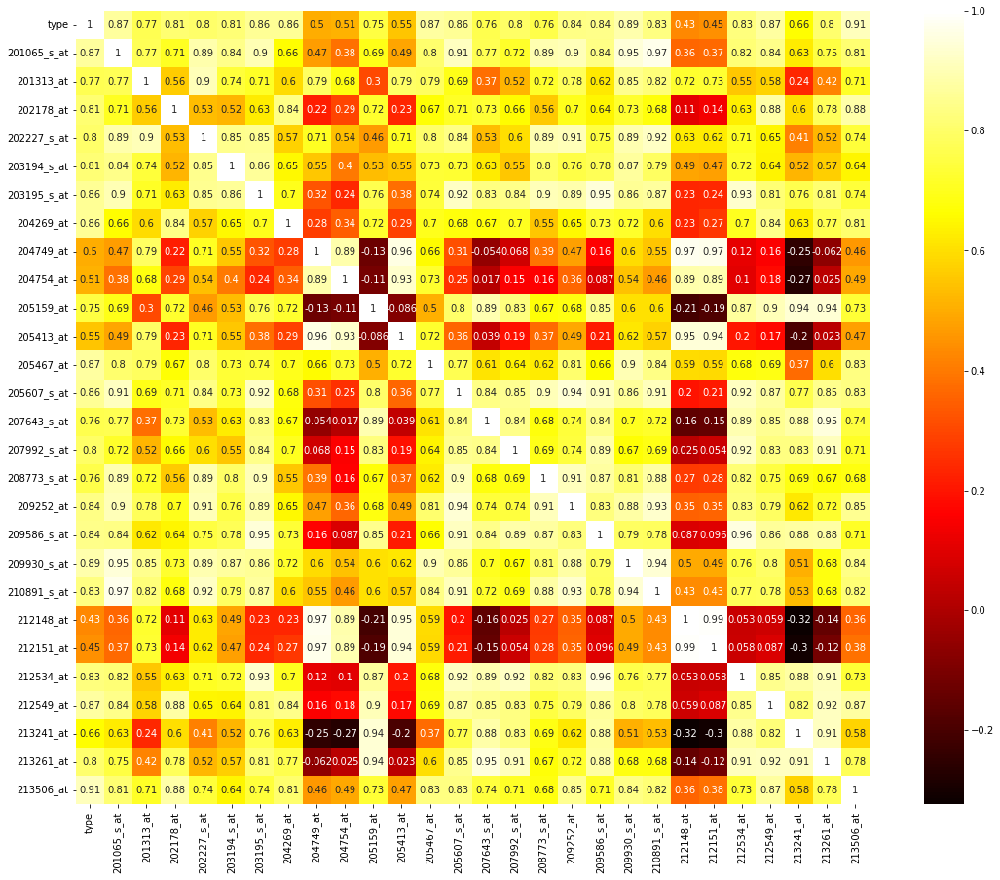

In [20]:
plt.subplots(figsize=(20, 15))
top_corr_df = corr[top_feature].corr()
sns.heatmap(top_corr_df, annot=True, square=True, vmax=1, cmap='hot')
plt.show()

> Feature 212148_at, 204749_at has low correlation with all the features so dropping that one

In [21]:
## Just run it once only, dropping min correlated features

top_feature = top_feature.drop(['212148_at','204749_at'])
top_feature

Index(['type', '201065_s_at', '201313_at', '202178_at', '202227_s_at',
       '203194_s_at', '203195_s_at', '204269_at', '204754_at', '205159_at',
       '205413_at', '205467_at', '205607_s_at', '207643_s_at', '207992_s_at',
       '208773_s_at', '209252_at', '209586_s_at', '209930_s_at', '210891_s_at',
       '212151_at', '212534_at', '212549_at', '213241_at', '213261_at',
       '213506_at'],
      dtype='object')

In [22]:
top_feature.shape

(26,)

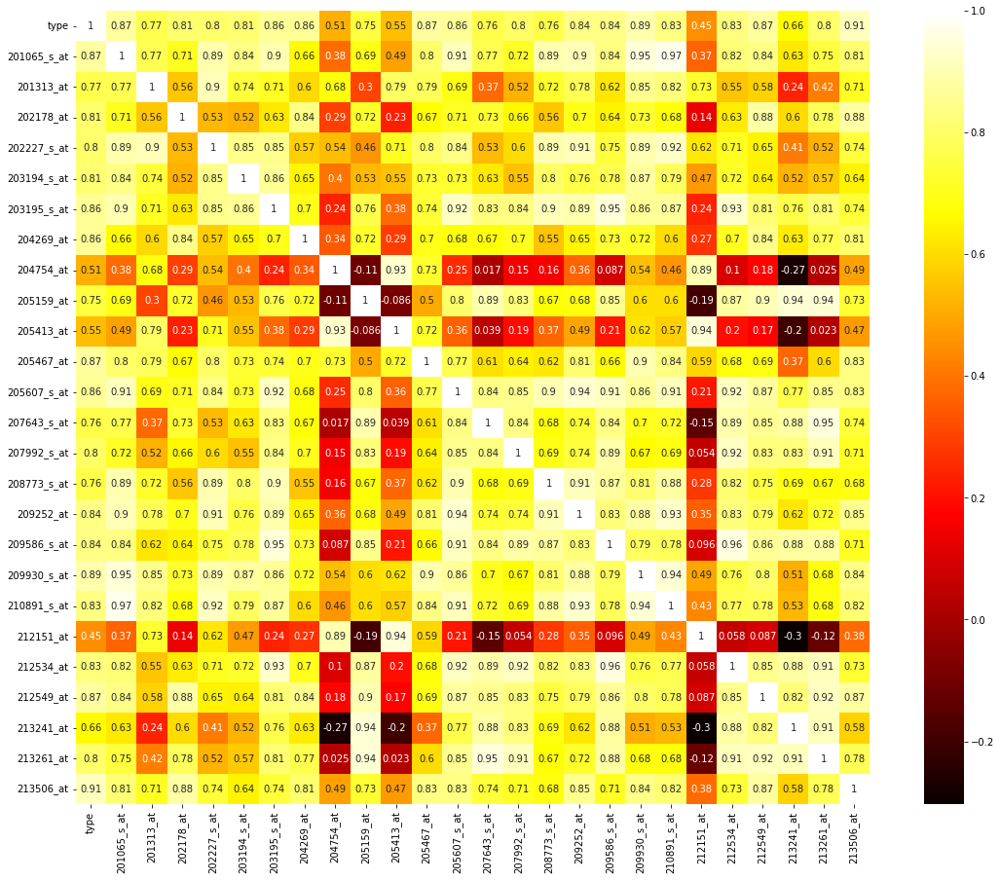

In [23]:
plt.subplots(figsize=(20, 15))
top_corr_df = corr[top_feature].corr()
sns.heatmap(top_corr_df, annot=True, square=True, vmax=1, cmap='hot')
plt.show()

In [24]:
top_corr_df.head()

,type,201065_s_at,201313_at,202178_at,202227_s_at,203194_s_at,203195_s_at,204269_at,204754_at,205159_at,...,209252_at,209586_s_at,209930_s_at,210891_s_at,212151_at,212534_at,212549_at,213241_at,213261_at,213506_at
type,1.000000,0.867704,0.767723,0.810405,0.803221,0.814640,0.858118,0.858150,0.513161,0.751320,...,0.837298,0.840437,0.891355,0.832759,0.446456,0.828309,0.874231,0.661573,0.804333,0.910208
201065_s_at,0.867704,1.000000,0.773829,0.709547,0.888264,0.839821,0.897809,0.662079,0.379922,0.691278,...,0.903390,0.835886,0.945586,0.972786,0.366605,0.817186,0.840908,0.625032,0.748598,0.813123
201313_at,0.767723,0.773829,1.000000,0.561365,0.904064,0.741329,0.714339,0.595360,0.683547,0.303177,...,0.779081,0.621596,0.848321,0.822552,0.726599,0.553693,0.577434,0.237124,0.415943,0.713999
202178_at,0.810405,0.709547,0.561365,1.000000,0.532896,0.518063,0.625169,0.837145,0.294826,0.723960,...,0.698184,0.644472,0.725377,0.676766,0.139032,0.630143,0.878001,0.601043,0.781904,0.881374
202227_s_at,0.803221,0.888264,0.904064,0.532896,1.000000,0.846087,0.850259,0.573419,0.537130,0.462774,...,0.906741,0.749461,0.894212,0.919592,0.624602,0.709421,0.646101,0.412835,0.520377,0.741148


In [25]:
col = top_feature.tolist()

In [26]:
df_corr = df_base[col]
df_corr.head()

,type,201065_s_at,201313_at,202178_at,202227_s_at,203194_s_at,203195_s_at,204269_at,204754_at,205159_at,...,209252_at,209586_s_at,209930_s_at,210891_s_at,212151_at,212534_at,212549_at,213241_at,213261_at,213506_at
0,2,9.532331,6.269008,6.757339,7.073231,6.860163,7.109435,8.512512,5.653065,9.078009,...,7.194465,7.720869,7.965894,9.403971,8.683374,7.134688,8.913826,7.771946,7.706568,5.787791
1,2,8.884798,6.982341,6.843217,7.542666,6.882518,7.143862,7.823427,6.047656,8.637051,...,7.485713,8.216813,8.853515,9.075144,8.398509,7.373589,8.845653,7.316809,7.745907,6.803478
2,2,9.512955,7.071630,6.707098,7.767014,7.152021,7.677094,7.756487,6.162619,8.459265,...,7.606895,8.497705,9.230471,9.357456,8.377580,7.869100,8.989415,7.622243,7.809614,7.162375
3,2,9.530411,6.629178,6.880654,7.676247,6.892638,7.421239,7.844342,5.754794,9.196185,...,7.383132,8.368311,9.312282,9.306596,8.446711,7.702027,9.415800,8.259538,7.586838,7.147100
4,2,9.654743,6.747591,6.961112,7.403803,6.630566,7.326550,8.072256,6.246594,8.953490,...,7.307591,7.881512,8.093987,9.493912,8.279398,7.671701,9.033007,7.969667,7.275322,5.969401


#### Profile Report for all the features

In [27]:
pp.ProfileReport(df_corr)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### Categorizing X and Y

In [28]:
X = df_corr.drop(['type'], axis= 1)
X_columns = X.columns
X_columns

Index(['201065_s_at', '201313_at', '202178_at', '202227_s_at', '203194_s_at',
       '203195_s_at', '204269_at', '204754_at', '205159_at', '205413_at',
       '205467_at', '205607_s_at', '207643_s_at', '207992_s_at', '208773_s_at',
       '209252_at', '209586_s_at', '209930_s_at', '210891_s_at', '212151_at',
       '212534_at', '212549_at', '213241_at', '213261_at', '213506_at'],
      dtype='object')

In [29]:
y = df_corr['type']
y.tail()

59    4
60    4
61    4
62    4
63    4
Name: type, dtype: int32

In [30]:
X.shape, y.shape

((64, 25), (64,))

In [31]:
print(f"We have {X_columns.shape[0]} features which are highly related to the Lukemia")

We have 25 features which are highly related to the Lukemia


### Scaling

In [32]:
### Try to scaling after splitting and K fold of data

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_scal = scaler.fit_transform(X)
df_X = pd.DataFrame(X_scal, columns=X_columns)
df_X.head()

,201065_s_at,201313_at,202178_at,202227_s_at,203194_s_at,203195_s_at,204269_at,204754_at,205159_at,205413_at,...,209252_at,209586_s_at,209930_s_at,210891_s_at,212151_at,212534_at,212549_at,213241_at,213261_at,213506_at
0,0.159235,-0.635047,-0.378241,0.027417,0.763035,-0.228541,1.828490,-0.468203,0.213512,0.580328,...,-0.638146,-0.461822,-0.457539,0.075045,1.366905,-0.843746,-0.095182,0.043539,-0.131115,-0.186527
1,-1.046527,0.885957,-0.207285,0.742327,0.808672,-0.158455,0.093184,0.445545,-0.119596,0.549387,...,0.104401,0.458748,0.383237,-0.476319,0.982238,-0.368011,-0.225432,-0.246991,-0.088749,0.571237
2,0.123155,1.076344,-0.478255,1.083989,1.358835,0.927087,-0.075388,0.711761,-0.253898,0.480481,...,0.413358,0.980138,0.740300,-0.002950,0.953976,0.618730,0.049236,-0.052022,-0.020139,0.838996
3,0.155661,0.132925,-0.132760,0.945758,0.829331,0.406224,0.145854,-0.232630,0.302784,0.356769,...,-0.157134,0.739959,0.817793,-0.088229,1.047327,0.286027,0.863876,0.354785,-0.260059,0.827600
4,0.387177,0.385412,0.027408,0.530850,0.294336,0.213458,0.719803,0.906222,0.119448,0.624159,...,-0.349727,-0.163636,-0.336206,0.225855,0.821397,0.225638,0.132521,0.169751,-0.595549,-0.051035


### Train Test Split with Stratified Sampling

In [33]:
X_train, X_test, y_train, y_test = train_test_split(X_scal,y,test_size=0.2,stratify=y, random_state=11)
print(f"Features Training data: {X_train.shape}")
print(f"Features Test data: {X_test.shape}")

Features Training data: (51, 25)
Features Test data: (13, 25)


In [34]:
y_train.shape, y_test.shape

((51,), (13,))

In [35]:
print(f"PORTION OF TYPE IN ORIGINAL DATA\n{y.value_counts() / len(y)}\n\n" +
      f"PORTION OF TYPE IN TRAIN DATA\n{y_train.value_counts() / len(y_train)}\n\n"+
      f"PORTION OF TYPE IN TEST DATA\n{y_test.value_counts() / len(y_test)}\n\n")

PORTION OF TYPE IN ORIGINAL DATA
0    0.40625
1    0.15625
3    0.15625
4    0.15625
2    0.12500
Name: type, dtype: float64

PORTION OF TYPE IN TRAIN DATA
0    0.411765
1    0.156863
3    0.156863
4    0.156863
2    0.117647
Name: type, dtype: float64

PORTION OF TYPE IN TEST DATA
0    0.384615
4    0.153846
3    0.153846
1    0.153846
2    0.153846
Name: type, dtype: float64




### KNN Model

In [36]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

#### K Fold Cross Validation

In [37]:
cv = KFold(n_splits=5, random_state=11, shuffle=True)

#### Hypertuning parameter using GridSearchCV

In [38]:
knn = KNeighborsClassifier()
param_grid = {'n_neighbors': np.arange(1, 25)}
knn_gscv = GridSearchCV(knn, param_grid, cv=cv)
knn_gscv.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=11, shuffle=True),
             estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24])})

In [39]:
knn_gscv.best_params_

{'n_neighbors': 1}

In [40]:
knn_gscv.best_score_

0.9217948717948719

#### Fitting model with Hyperparameter

In [41]:
knn = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(knn, X, y, cv=cv)
print(f"Cross Validation score: {scores}")
print(f"CV Mean: {np.mean(scores)}")

Cross Validation score: [0.92307692 1.         0.92307692 0.76923077 0.91666667]
CV Mean: 0.9064102564102564


In [42]:
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

### Metrics

In [43]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import accuracy_score

In [44]:
def plot_confusion_matrix(cm, classes, normalized=True, cmap='bone'):
    plt.figure(figsize=[7, 6])
    norm_cm = cm
    if normalized:
        norm_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        sns.heatmap(norm_cm, annot=cm, fmt='g', xticklabels=classes, yticklabels=classes, cmap=cmap)

In [45]:
def model_fitness(y_test, y_pred):
    print(f"Accuracy Score: {accuracy_score(y_test, y_pred)*100}")
    cm = confusion_matrix(y_test, y_pred)
    print(f"Classification Report:\n {classification_report(y_test, y_pred)}")
    print(f"Consufion Matrix:")
    plot_confusion_matrix(cm, classes= le.classes_)

Accuracy Score: 84.61538461538461
Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.80      0.89         5
           1       0.50      1.00      0.67         2
           2       1.00      0.50      0.67         2
           3       1.00      1.00      1.00         2
           4       1.00      1.00      1.00         2

    accuracy                           0.85        13
   macro avg       0.90      0.86      0.84        13
weighted avg       0.92      0.85      0.85        13

Consufion Matrix:


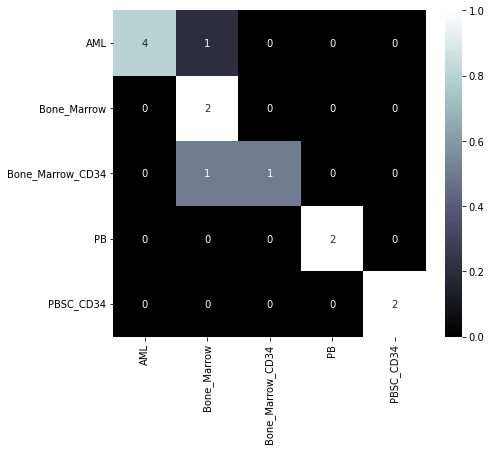

In [46]:
model_fitness(y_test, y_pred)

+ From the above report it is clear from class Bone_Marrow_CD34 f1 score is 67% due to poor recall, due to low training set data
+ We could try SMOTE with KNN to upsample data in minority class


### SVM Classifier

In [47]:
from sklearn import svm

In [48]:
C = 1.0 # Regularization parameter
# linear, rbf kernel
models = svm.SVC(kernel='rbf',C=C)
models.fit(X_train, y_train)
y_pred = models.predict(X_test)

Accuracy Score: 92.3076923076923
Classification Report:
               precision    recall  f1-score   support

           0       0.83      1.00      0.91         5
           1       1.00      1.00      1.00         2
           2       1.00      0.50      0.67         2
           3       1.00      1.00      1.00         2
           4       1.00      1.00      1.00         2

    accuracy                           0.92        13
   macro avg       0.97      0.90      0.92        13
weighted avg       0.94      0.92      0.91        13

Consufion Matrix:


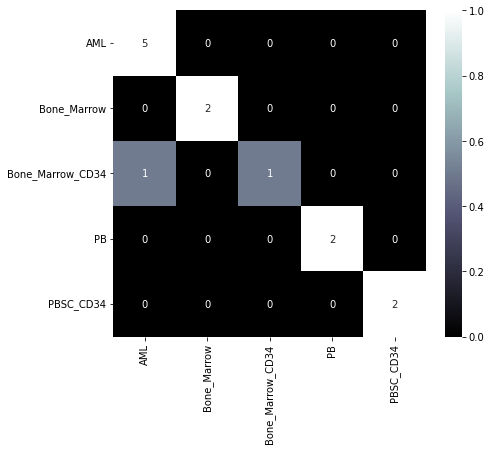

In [49]:
model_fitness(y_test, y_pred)

### GradientBoosting Classifier

In [50]:
from sklearn.ensemble import GradientBoostingClassifier

Accuracy Score: 84.61538461538461
Classification Report:
               precision    recall  f1-score   support

           0       0.71      1.00      0.83         5
           1       1.00      0.50      0.67         2
           2       1.00      0.50      0.67         2
           3       1.00      1.00      1.00         2
           4       1.00      1.00      1.00         2

    accuracy                           0.85        13
   macro avg       0.94      0.80      0.83        13
weighted avg       0.89      0.85      0.83        13

Consufion Matrix:


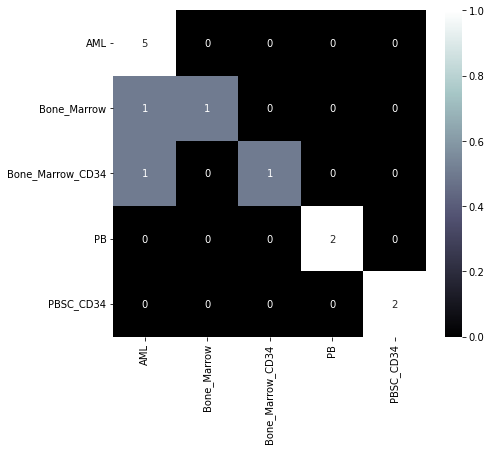

In [51]:
gb_clf = GradientBoostingClassifier()
gb_clf.fit(X_train, y_train)
y_pred = gb_clf.predict(X_test)
model_fitness(y_test, y_pred)

### Decision Tree Classifier

In [52]:
from sklearn.tree import DecisionTreeClassifier

Accuracy Score: 69.23076923076923
Classification Report:
               precision    recall  f1-score   support

           0       0.71      1.00      0.83         5
           1       0.00      0.00      0.00         2
           2       0.50      0.50      0.50         2
           3       1.00      0.50      0.67         2
           4       0.67      1.00      0.80         2

    accuracy                           0.69        13
   macro avg       0.58      0.60      0.56        13
weighted avg       0.61      0.69      0.62        13

Consufion Matrix:


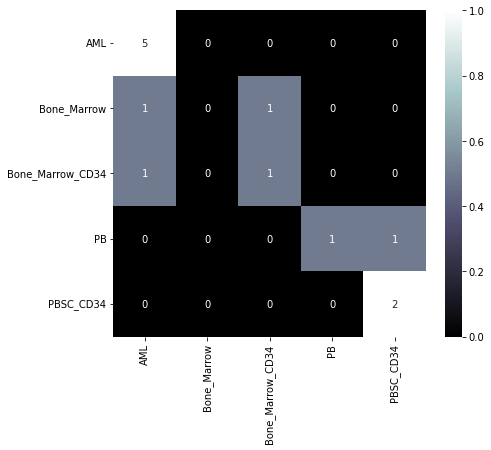

In [53]:
dt_clf = DecisionTreeClassifier()
dt_clf.fit(X_train, y_train)
y_pred = dt_clf.predict(X_test)
model_fitness(y_test, y_pred)

### XGBoost

In [55]:
import xgboost as xgb
from xgboost import XGBClassifier
from xgboost.sklearn import XGBClassifier

[21:14:55] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:576: 
Parameters: { "boosting", "feature_fraction", "metric", "num_iterations", "scale_pos_weight" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


Accuracy Score: 92.3076923076923
Classification Report:
               precision    recall  f1-score   support

           0       0.83      1.00      0.91         5
           1       1.00      1.00      1.00         2
           2       1.00      0.50      0.67         2
           3       1.00      1.00      1.00         2
           4       1.00      1.00      1.00         2

    accuracy                           0.92        13
   macro avg       0.97      0.90      0.92        13
weighted avg       0.94 

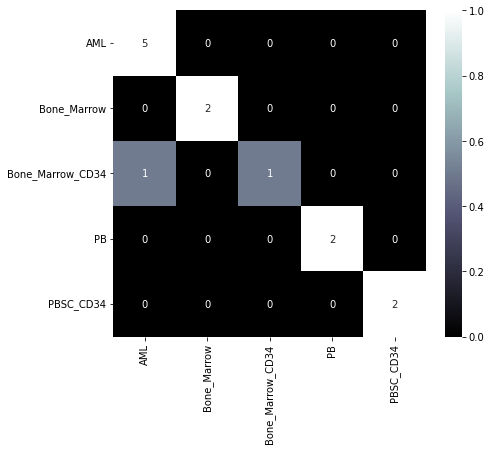

In [56]:
xgb_clf = XGBClassifier(num_class=5,
                        learning_rate=0.1,
                        num_iterations=1000,
                        max_depth=10,
                        feature_fraction=0.7, 
                        scale_pos_weight=1.5,
                        boosting='gbdt',
                        metric='multiclass',
                        eval_metric='mlogloss')
xgb_clf.fit(X_train, y_train)
y_pred = xgb_clf.predict(X_test)
model_fitness(y_test, y_pred)